In this notebook we use the dataset we made in previous notebook (green_index_calculation.ipynb) and plot the trajectories in city map. In this notebook we have:


*   Discovering the correlation between distance and time at each stop
*   Scatter Plots for showing the correaltion between distance and time
*   Plotting all the trajectories in city map
*   Defining the outliers and plotting them on the map




In [ ]:
!pip install contextily

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 19.3 MB 31.4 MB/s 


In [ ]:
! pip install pysal

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 55 kB 2.2 MB/s 
     |████████████████████████████████| 147 kB 8.3 MB/s 
     |████████████████████████████████| 60 kB 6.5 MB/s 
     |████████████████████████████████| 84 kB 2.8 MB/s 
     |████████████████████████████████| 116 kB 27.4 MB/s 
     |████████████████████████████████| 2.4 MB 43.8 MB/s 
     |████████████████████████████████| 209 kB 33.9 MB/s 
     |████████████████████████████████| 5.7 MB 42.1 MB/s 
     |████████████████████████████████| 41 kB 313 kB/s 
     |████████████████████████████████| 46 kB 3.0 MB/s 
     |████████████████████████████████| 243 kB 58.3 MB/s 
     |████████████████████████████████| 1.0 MB 55.4 MB/s 
     |████████████████████████████████| 179 kB 51.8 MB/s 
     |████████████████████████████████| 2.1 MB 39.9 MB/s 
     |████████████████████████████████| 16.7 MB 61.6 MB/s 
     |████████████████████████████████| 6

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import folium
import contextily
import pysal

from geopy.distance import geodesic
import geopy.distance

from sklearn.neighbors import KDTree
from scipy import spatial
from scipy import stats
from scipy.spatial import distance

In [ ]:
# Opening all trajectories dataset, including each stop of trips, distances and number of trees around each stop 
all_tj = pd.read_csv('/content/all_tj_with_distance_Ntrees.csv')
all_tj.head()

,tripIndex,lat,lon,time,corrected_time,lat-lon,lat_next,lon_next,distance_km,distance_in_minutes,number_trees
0,349,41.904218,12.679084,0,0.0,"(41.90421784974773, 12.67908421134476)",41.898969,12.678453,0.585292,0.005286,12
1,349,41.898969,12.678453,55,55.0,"(41.898969469324754, 12.678453128461776)",41.901686,12.678275,0.302092,0.002722,126
2,349,41.901686,12.678275,645,590.0,"(41.901685997328975, 12.678274506347506)",41.896203,12.676946,0.618901,0.005642,107
3,349,41.896203,12.676946,1291,646.0,"(41.89620294246636, 12.676946426407458)",41.895846,12.675373,0.136472,0.001614,123
4,349,41.895846,12.675373,1292,1.0,"(41.89584603111947, 12.67537280875032)",41.895602,12.675157,0.032455,0.000325,72


In [ ]:
# Opening the trajectories dataset, including each trip's green indexe in time and distance 
grn = pd.read_csv('/content/green_index_df.csv')
grn.head()

,tripIndex,number_trees,time,distance_km,greenIndex_time,greenIndex_distance
0,40,272,2976,0.882902,0.091398,308.074794
1,53,2248,1763,3.943713,1.275099,570.021245
2,59,1564,2881,3.383147,0.542867,462.291459
3,60,1511,1200,2.435823,1.259167,620.324168
4,85,142,600,0.889538,0.236667,159.633354


## Discovering the correlation between distance and time at each stop


In [ ]:
# Adding a new column of 'Range_of_time' which divides the time in four categories

all_tj['Range_of_time'] = pd.Series(dtype='float')

for i, row in all_tj.iterrows():
    if all_tj['corrected_time'][i] < 900:
        all_tj['Range_of_time'][i] = "<0-15> mins"
    elif (all_tj['corrected_time'][i] > 900) & (all_tj['time'][i] < 1800):
        all_tj['Range_of_time'][i] = "<15-30> mins"
    elif (all_tj['corrected_time'][i] > 1800) & (all_tj['time'][i] < 2700):
        all_tj['Range_of_time'][i] = "<30-45> mins"
    else:
      all_tj['Range_of_time'][i] = "<45-60> mins"  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


In [ ]:
all_tj.groupby('Range_of_time')['tripIndex'].count()

Range_of_time
<0-15> mins     241101
<15-30> mins      3293
<30-45> mins      1218
<45-60> mins      4744
Name: tripIndex, dtype: int64

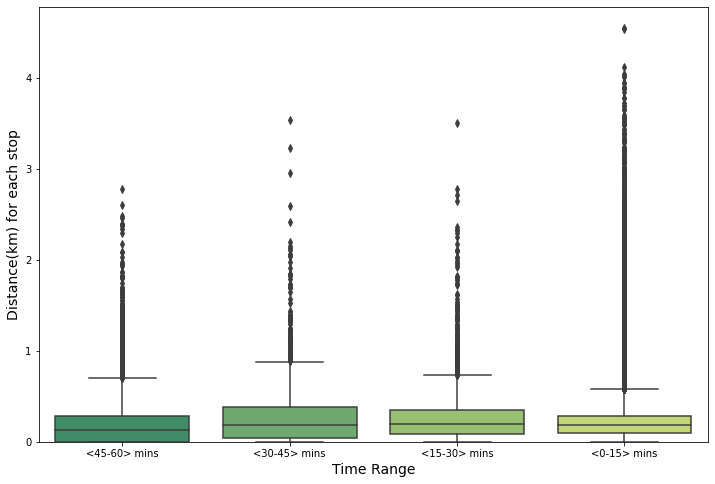

In [ ]:
# Plotting distribution of distance in four time range categories from all trajectories
plt.figure(figsize = (12, 8))
ax = sns.boxplot(x = 'Range_of_time', y = 'distance_km',data = all_tj, palette = "summer", order = ["<45-60> mins", "<30-45> mins", "<15-30> mins", "<0-15> mins"])
ax.set_xlabel('Time Range', fontsize = 14)
ax.set_ylabel('Distance(km) for each stop', fontsize = 14)
plt.ylim(0)
#plt.savefig('Boxplot_without_outlier.png', dpi = 300)
plt.show()

In [ ]:
# Excluding the zeros both in time and distance
all_tj_no_Zero = all_tj[(all_tj['distance_km'] != 0) & (all_tj['corrected_time'] != 0)]
all_tj_no_Zero.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 159368 entries, 1 to 250354
Data columns (total 12 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   tripIndex            159368 non-null  int64  
 1   lat                  159368 non-null  float64
 2   lon                  159368 non-null  float64
 3   time                 159368 non-null  int64  
 4   corrected_time       159368 non-null  float64
 5   lat-lon              159368 non-null  object 
 6   lat_next             159368 non-null  float64
 7   lon_next             159368 non-null  float64
 8   distance_km          159368 non-null  float64
 9   distance_in_minutes  159368 non-null  float64
 10  number_trees         159368 non-null  int64  
 11  Range_of_time        159368 non-null  object 
dtypes: float64(7), int64(3), object(2)
memory usage: 15.8+ MB


In [ ]:
all_tj_no_Zero_dist = all_tj[all_tj['distance_km'] != 0]
all_tj_no_Zero_dist.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 219832 entries, 0 to 250354
Data columns (total 12 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   tripIndex            219832 non-null  int64  
 1   lat                  219832 non-null  float64
 2   lon                  219832 non-null  float64
 3   time                 219832 non-null  int64  
 4   corrected_time       219832 non-null  float64
 5   lat-lon              219832 non-null  object 
 6   lat_next             219832 non-null  float64
 7   lon_next             219832 non-null  float64
 8   distance_km          219832 non-null  float64
 9   distance_in_minutes  219832 non-null  float64
 10  number_trees         219832 non-null  int64  
 11  Range_of_time        219832 non-null  object 
dtypes: float64(7), int64(3), object(2)
memory usage: 21.8+ MB


In [ ]:
print("Max of time at each stop is: ")
print(all_tj['corrected_time'].max())
print('Max of distance at each stop is: ')
print(all_tj['distance_km'].max())

Max of time at each stop is: 
3600.0
Max of distance at each stop is: 
4.5509903611733895


In [ ]:
# For distance at the end of each tripIndex we have distance zero, because of lat lon next
all_tj.head(20)

,tripIndex,lat,lon,time,corrected_time,lat-lon,lat_next,lon_next,distance_km,distance_in_minutes,number_trees,Range_of_time
0,349,41.904218,12.679084,0,0.0,"(41.90421784974773, 12.67908421134476)",41.898969,12.678453,0.585292,0.005286,12,<0-15> mins
1,349,41.898969,12.678453,55,55.0,"(41.898969469324754, 12.678453128461776)",41.901686,12.678275,0.302092,0.002722,126,<0-15> mins
2,349,41.901686,12.678275,645,590.0,"(41.901685997328975, 12.678274506347506)",41.896203,12.676946,0.618901,0.005642,107,<0-15> mins
3,349,41.896203,12.676946,1291,646.0,"(41.89620294246636, 12.676946426407458)",41.895846,12.675373,0.136472,0.001614,123,<0-15> mins
4,349,41.895846,12.675373,1292,1.0,"(41.89584603111947, 12.67537280875032)",41.895602,12.675157,0.032455,0.000325,72,<0-15> mins
5,349,41.895602,12.675157,1301,9.0,"(41.895602118089975, 12.675157462438952)",41.894935,12.675231,0.074301,0.000671,62,<0-15> mins
6,349,41.894935,12.675231,1388,87.0,"(41.89493543576834, 12.67523116325905)",41.897484,12.673911,0.303520,0.002870,51,<0-15> mins
7,349,41.897484,12.673911,1485,97.0,"(41.89748392297537, 12.673911165468567)",41.897205,12.678455,0.378306,0.004552,70,<0-15> mins
8,349,41.897205,12.678455,2560,1075.0,"(41.89720485128779, 12.678454635061527)",41.897205,12.678455,0.000000,0.000000,136,<45-60> mins
9,4737,41.925546,12.414767,0,0.0,"(41.92554612853569, 12.414767206996896)",41.925740,12.414022,0.065445,0.000770,149,<0-15> mins


In [ ]:
# So we have 30524 rows with zero distances
all_tj[all_tj['distance_km'] == 0]

,tripIndex,lat,lon,time,corrected_time,lat-lon,lat_next,lon_next,distance_km,distance_in_minutes,number_trees
8,349,41.897205,12.678455,2560,1075.0,"(41.89720485128779, 12.678454635061527)",41.897205,12.678455,0.0,0.0,136
12,4737,41.926607,12.410988,467,121.0,"(41.926607376028265, 12.410987578330982)",41.926607,12.410988,0.0,0.0,106
15,4800,41.896588,12.560868,1010,869.0,"(41.896588189389895, 12.560868412643948)",41.896588,12.560868,0.0,0.0,204
26,8586,41.944513,12.518478,1044,0.0,"(41.94451348174219, 12.518478480239292)",41.944513,12.518478,0.0,0.0,88
31,9746,41.888376,12.523143,545,141.0,"(41.88837639781306, 12.523142777562482)",41.888376,12.523143,0.0,0.0,164
...,...,...,...,...,...,...,...,...,...,...,...
250324,416740,41.901639,12.588815,3032,27.0,"(41.90163923272927, 12.588815299243077)",41.901639,12.588815,0.0,0.0,302
250329,424239,41.892406,12.569178,3035,2848.0,"(41.89240595417361, 12.569177676319098)",41.892406,12.569178,0.0,0.0,202
250334,431719,41.903292,12.502976,309,47.0,"(41.90329155654194, 12.502975806116808)",41.903292,12.502976,0.0,0.0,42
250337,433219,41.908499,12.543056,600,299.0,"(41.90849866825764, 12.543056181435826)",41.908499,12.543056,0.0,0.0,86


### Scatter Plots for showing the correaltion between distance and time

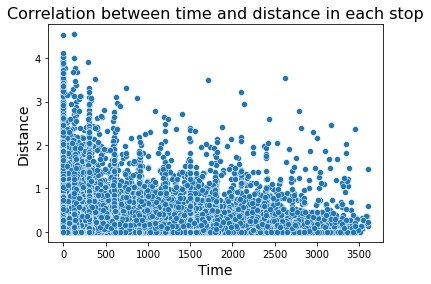

In [ ]:
# All of the trajectories
sns.scatterplot(data = all_tj, x = 'corrected_time', y = 'distance_km')
plt.title('Correlation between time and distance in each stop', fontsize = 16)
# Set x-axis label
plt.xlabel('Time', fontsize = 14)
# Set y-axis label
plt.ylabel('Distance', fontsize = 14)
#plt.savefig('scatterplot2.png', dpi = 100)
plt.show()

We have four lines with no time and 4 km of distance

In [ ]:
all_tj[(all_tj['distance_km'] > 4) & (all_tj['corrected_time'] < 60)]

,tripIndex,lat,lon,time,corrected_time,lat-lon,lat_next,lon_next,distance_km,distance_in_minutes,number_trees
150088,33458,41.858085,12.396139,0,0.0,"(41.85808477412175, 12.396138984020292)",41.844763,12.350843,4.042056,0.047214,35
188156,229476,41.864162,12.497540,0,0.0,"(41.86416203555648, 12.497540291669342)",41.887608,12.542259,4.534518,0.050492,60
199607,147466,41.865741,12.445184,0,0.0,"(41.86574121742247, 12.4451843208818)",41.896079,12.471503,4.015807,0.040163,150
236955,101320,41.895858,12.563062,0,0.0,"(41.8958580675036, 12.563061839994964)",41.930649,12.545724,4.123306,0.038872,206


For example one of them is this one:

In [ ]:
all_tj[all_tj['tripIndex'] == 33458]

,tripIndex,lat,lon,time,corrected_time,lat-lon,lat_next,lon_next,distance_km,distance_in_minutes,number_trees
150088,33458,41.858085,12.396139,0,0.0,"(41.85808477412175, 12.396138984020292)",41.844763,12.350843,4.042056,0.047214,35
150089,33458,41.844763,12.350843,3394,3394.0,"(41.84476334695255, 12.350843179553852)",41.845934,12.350847,0.130037,0.001171,19
150090,33458,41.845934,12.350847,3481,87.0,"(41.84593410544769, 12.35084656292934)",41.845934,12.350847,0.000000,0.000000,18


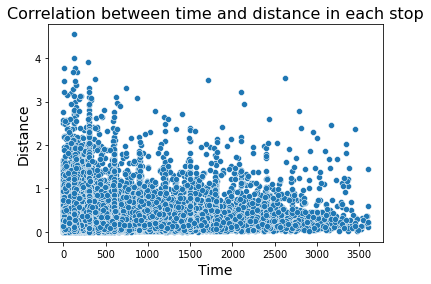

In [ ]:
# All trajectories with removing zeros both in time and distance

sns.scatterplot(data = all_tj_no_Zero, x = 'corrected_time', y = 'distance_km')
plt.title('Correlation between time and distance in each stop', fontsize = 16)
# Set x-axis label
plt.xlabel('Time', fontsize = 14)
# Set y-axis label
plt.ylabel('Distance', fontsize = 14)
#plt.savefig('scatterplot2.png', dpi = 100)

plt.show()

I figured out that we have a lot of zero destances at the end of each tripIndex, because of putting the same lat and lon for the last row. But removing zeros didn't change it a lot. Still we have a lot of near zero points. 

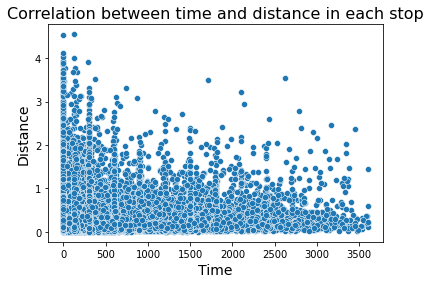

In [ ]:
# All trajectoreis with removing zeros in distance
sns.scatterplot(data = all_tj_no_Zero_dist, x = 'corrected_time', y = 'distance_km')
plt.title('Correlation between time and distance in each stop', fontsize = 16)
# Set x-axis label
plt.xlabel('Time', fontsize = 14)
# Set y-axis label
plt.ylabel('Distance', fontsize = 14)
#plt.savefig('scatterplot2.png', dpi = 100)
plt.show()

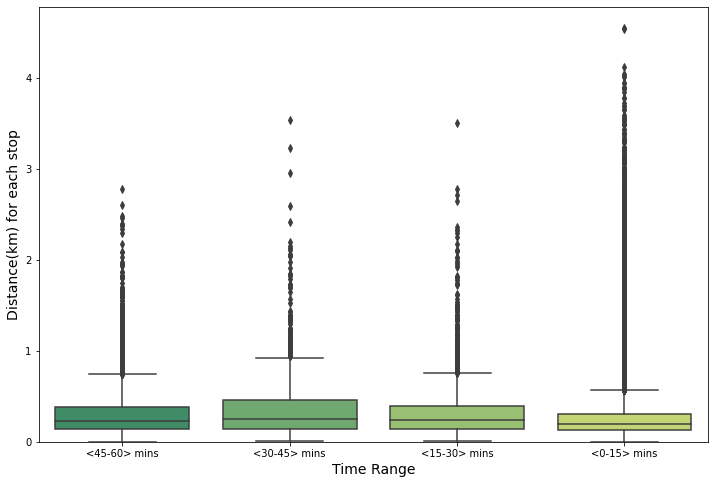

In [ ]:
# Plotting distribution of distance in four time range categories from all trajectories
plt.figure(figsize = (12, 8))
ax = sns.boxplot(x = 'Range_of_time', y = 'distance_km',data = all_tj_no_Zero_dist, palette = "summer", order = ["<45-60> mins", "<30-45> mins", "<15-30> mins", "<0-15> mins"])
ax.set_xlabel('Time Range', fontsize = 14)
ax.set_ylabel('Distance(km) for each stop', fontsize = 14)
plt.ylim(0)
#plt.savefig('Boxplot_without_outlier.png', dpi = 300)
plt.show()

In [ ]:
# Green paths in the sense of green_index_time

green_trips_time = grn[grn['greenIndex_time'] > grn['greenIndex_time'].mean()]
green_trips_time.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7513 entries, 1 to 23847
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   tripIndex            7513 non-null   int64  
 1   number_trees         7513 non-null   int64  
 2   time                 7513 non-null   int64  
 3   distance_km          7513 non-null   float64
 4   greenIndex_time      7513 non-null   float64
 5   greenIndex_distance  7513 non-null   float64
dtypes: float64(3), int64(3)
memory usage: 410.9 KB


In [ ]:
# Green paths in the sense of green_index_distance

green_trips_distance = grn[grn['greenIndex_distance'] > grn['greenIndex_distance'].mean()]
green_trips_distance.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9312 entries, 5 to 23851
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   tripIndex            9312 non-null   int64  
 1   number_trees         9312 non-null   int64  
 2   time                 9312 non-null   int64  
 3   distance_km          9312 non-null   float64
 4   greenIndex_time      9312 non-null   float64
 5   greenIndex_distance  9312 non-null   float64
dtypes: float64(3), int64(3)
memory usage: 509.2 KB


## Plotting all the trajectories in city map

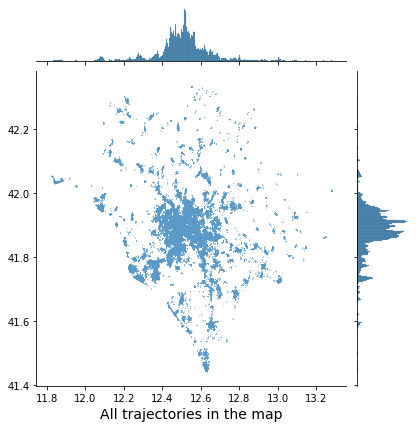

In [ ]:
ax = sns.jointplot(x = 'lon', y = 'lat', data = all_tj, s = 0.5)
ax.set_axis_labels('All trajectories in the map', size = 14)
#plt.savefig('scatterplot_traj_map.png', dpi = 300)
plt.show()

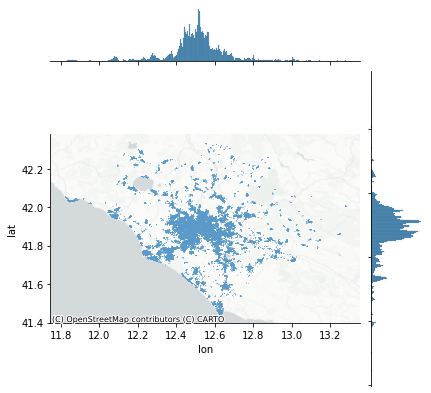

In [ ]:
joint_axes = sns.jointplot(x = 'lon', y = 'lat', data = all_tj, s = 0.5)
contextily.add_basemap(joint_axes.ax_joint,
    crs="EPSG:4326",
    source=contextily.providers.CartoDB.PositronNoLabels)
plt.savefig('scatterplot_traj_map1.png', dpi = 300)

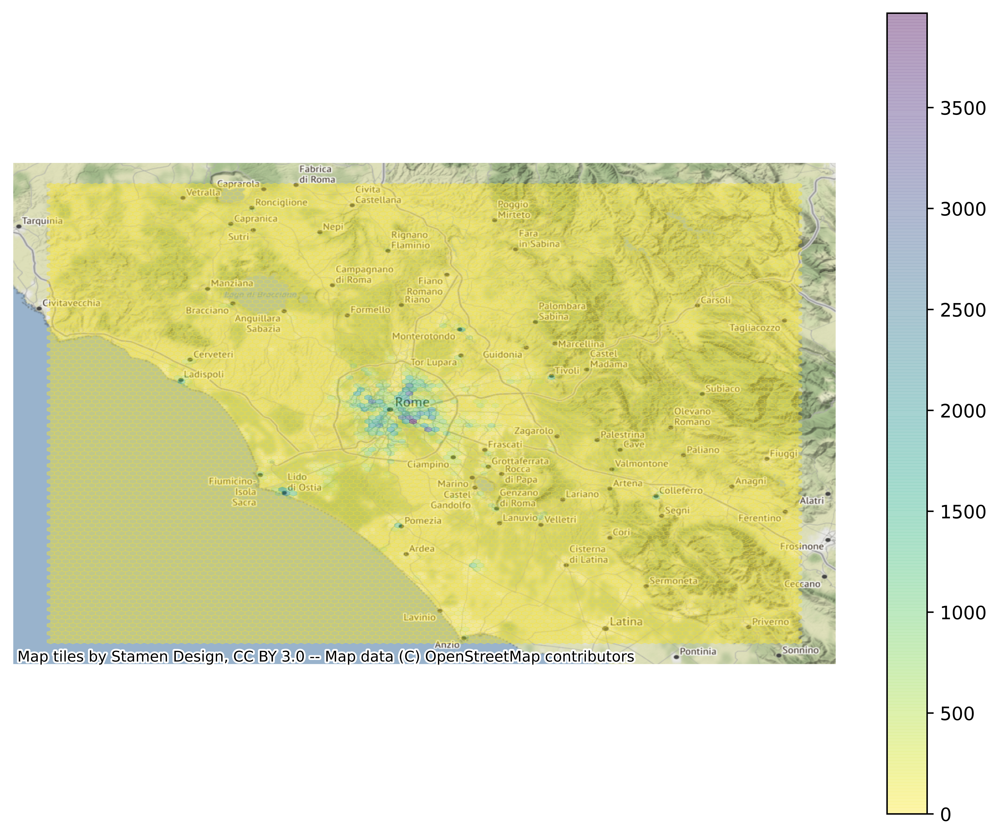

In [ ]:
fig = plt.figure(figsize = (10,10), dpi = 1000)
ax = fig.add_subplot(111)
hb = ax.hexbin(
    all_tj['lon'], 
    all_tj['lat'], gridsize = 100, alpha = 0.4, linewidths = 0.2, cmap = 'viridis_r')
contextily.add_basemap(ax, crs=4326)
plt.colorbar(hb)
ax.set_axis_off()
#plt.savefig('heatmap_map1.png')  
plt.show()
plt.close()

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


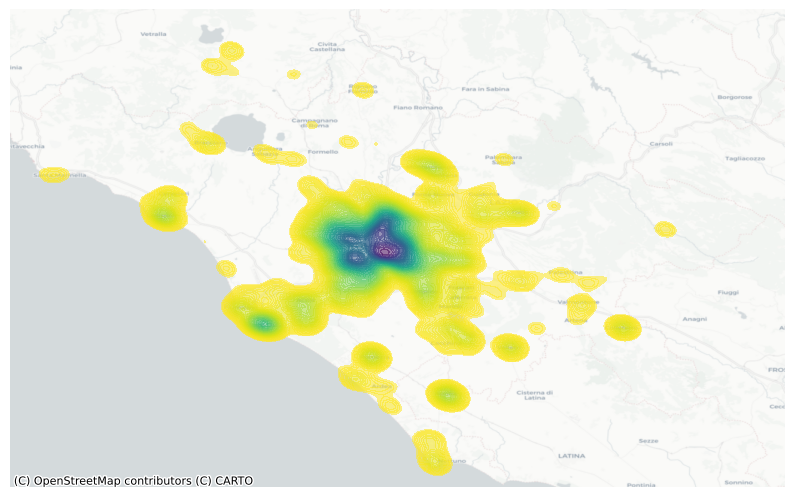

In [ ]:
fig = plt.figure(figsize = (10,10), dpi = 100)
ax = fig.add_subplot(111)
sns.kdeplot(
    all_tj['lon'], 
    all_tj['lat'],
    n_levels = 100, 
    shade = True,
    alpha = 0.55, 
    cmap = 'viridis_r')
contextily.add_basemap(
    ax, 
    source=contextily.providers.CartoDB.Positron, crs = 4326)
ax.set_axis_off()
plt.show()
plt.close()

# Plotting the outliers in map

In [ ]:
from branca.element import Figure

In [ ]:
# Creating a folium map to add the outliers
fig = Figure(height=550,width=750)
map = folium.Map(location=[all_tj.lat.mean(), all_tj.lon.mean()], control_scale=True)
fig.add_child(map)

In [ ]:
# Finding the long trips
print("The mean of the distances are: ")
print(grn['distance_km'].mean())
print("Trips longer than 20 km:  ")
grn[grn['distance_km'] > 20]

The mean of the distances are: 
1.8642962193864203
Trips longer than 20 km:  


,tripIndex,number_trees,time,distance_km,greenIndex_time,greenIndex_distance
13416,256135,24738,842,51.28402,29.380048,482.372477


In [ ]:
outliers_tripIndex = outliers_df['tripIndex'].tolist()
len(outliers_tripIndex)
outliers_tripIndex = np.asarray(outliers_tripIndex)
outliers_tripIndex

array([  7107,   7336,   7661,   8319,   9057,  11799,  15013,  17489,
        17679,  18224,  19009,  19916,  20290,  21078,  22457,  22766,
        26937,  27170,  27430,  29842,  31725,  32739,  35240,  38225,
        39048,  41925,  41981,  42476,  43883,  45461,  48143,  51003,
        53510,  56860,  58895,  59330,  60687,  61689,  63500,  65313,
        67058,  71601,  73874,  75689,  79278,  79514,  84445,  85396,
        86057,  92126,  92848,  94905,  95077,  99505, 103052, 105231,
       105511, 109747, 114503, 115510, 117192, 117252, 117925, 119981,
       121361, 122073, 125770, 125953, 126510, 130531, 131045, 132561,
       134117, 136776, 138536, 138831, 142906, 148591, 149001, 153526,
       154769, 155951, 157519, 158248, 160679, 161728, 162547, 167605,
       168754, 170063, 171944, 178240, 179336, 182575, 182687, 183521,
       191468, 193277, 193809, 197371, 198117, 199175, 202234, 203728,
       205556, 205962, 207775, 208167, 210521, 211171, 214784, 223668,
      

In [ ]:
trip_latlon_list = pd.DataFrame(columns=['tripIndex',	'lat',	'lon',	'time',	'corrected_time',	'lat-lon',	'lat_next',	'lon_next',	'distance_km',	'distance_in_minutes'	,'number_trees'])
list_of_list = []
for i in range(len(outliers_tripIndex)):
  df_green1 = all_tj[all_tj['tripIndex'] == outliers_tripIndex[i]]
  #print(type(df_green1['lat-lon']))
  trip_latlon_list = df_green1['lat-lon'].tolist()
  list_of_list.append(trip_latlon_list)
  outliers_df_lat_lon = outliers_df_lat_lon.append(df_green1, ignore_index=True)
outliers_df_lat_lon

,tripIndex,lat,lon,time,corrected_time,lat-lon,lat_next,lon_next,distance_km,distance_in_minutes,number_trees,distance_m,Range_of_time
0,7107,41.928591,12.425027,0,0.0,"(41.92859102300836, 12.425027147378463)",41.928400,12.423729,0.109747,0.001312,248,109.747466,<0-15> mins
1,7107,41.928400,12.423729,317,317.0,"(41.928400263544965, 12.423728880330255)",41.928883,12.424725,0.098462,0.001107,299,98.462296,<0-15> mins
2,7107,41.928883,12.424725,600,283.0,"(41.92888292668311, 12.424724595724673)",41.927028,12.425616,0.218904,0.002058,252,218.903857,<0-15> mins
3,7107,41.927028,12.425616,916,316.0,"(41.927027901269575, 12.42561594207113)",41.927028,12.425616,0.000000,0.000000,252,0.000000,<0-15> mins
4,7336,41.890669,12.541500,0,0.0,"(41.89066873111947, 12.54149960875032)",41.890530,12.541437,0.016313,0.000153,149,16.313245,<0-15> mins
...,...,...,...,...,...,...,...,...,...,...,...,...,...
9840,450045,41.875998,12.579293,903,300.0,"(41.87599775361845, 12.579293207355024)",41.875998,12.579293,0.000000,0.000000,266,0.000000,<0-15> mins
9841,455069,41.903986,12.590104,0,0.0,"(41.90398642610795, 12.590103652434046)",41.903034,12.590781,0.119838,0.001169,290,119.838064,<0-15> mins
9842,455069,41.903034,12.590781,299,299.0,"(41.9030335699904, 12.59078113613294)",41.901723,12.590217,0.152892,0.001427,218,152.891833,<0-15> mins
9843,455069,41.901723,12.590217,599,300.0,"(41.901723263158495, 12.590216549754665)",41.902776,12.590719,0.124157,0.001167,266,124.157325,<0-15> mins


In [ ]:
final_list =[[(41.92859102300836,12.425027147378463),(41.928400263544965,12.423728880330255),(41.92888292668311,12.424724595724673),(41.927027901269575,12.42561594207113)],[(41.89066873111947,12.54149960875032),(41.89052951808998,12.541436962438954),(41.89039733576834,12.54213486325905)],[(41.85765337915247,12.450930346304698),(41.85615212246496,12.450419023625155),(41.8557271617496,12.450704463315336),(41.85548696977546,12.450564941627542)],[(41.8154553435202,12.616794309028652),(41.81372825163952,12.617557471368144),(41.81277465231467,12.616192497294527)],[(41.93479588740347,12.441853153189587),(41.93481352336022,12.441472345763389),(41.93488009309137,12.439947202522102)],[(41.88980708110783,12.5647161015627),(41.88947553953143,12.56510518403735),(41.88991318740347,12.56478075318959),(41.89084142336022,12.563855945763388),(41.89149659309137,12.563957902522102)],[(41.879984723360224,12.501136045763388),(41.88072779309137,12.501446802522102),(41.88185201607469,12.501814137542198)],[(41.880245405174,12.514109787374538),(41.88053974866045,12.514955724368225),(41.88082670045824,12.514139537751666),(41.88080214866996,12.513871972345138)],[(41.89435344345158,12.416205531848302),(41.895000336827856,12.41853469799148),(41.89465090407049,12.418300512114802)],[(41.96628533953143,12.53080898403735),(41.96606628740347,12.530732853189589),(41.96552332336022,12.530934845763388),(41.96611369309137,12.531245602522102)],[(41.78710387000575,12.35728589557452),(41.7871567732966,12.357389724073268),(41.78749153376962,12.357636877683818),(41.78857526234595,12.356018003390806)],[(41.88689701192176,12.535886286717265),(41.88790886290907,12.536715836974656),(41.8880311720949,12.536501288572534),(41.88756129010625,12.536742110558851)],[(41.86180922879987,12.683312617402056),(41.86300996820865,12.684028597344868),(41.862212143308376,12.683655705882227)],[(41.92297358450789,12.502175460909848),(41.92245421591038,12.502565530520812),(41.92300159837627,12.503066256661528)],[(41.89691640487158,12.58267607975179),(41.8970757294712,12.584554113319683),(41.89688937261632,12.584937614110263)],[(41.94588952892482,12.519315428716796),(41.94563029781306,12.51942327756248),(41.94635991529872,12.518280886241232),(41.9468083064861,12.5194286044861)],[(41.91913257132735,12.485247047312502),(41.91838181486612,12.485773518062736),(41.91964116279992,12.484955196884655)],[(41.94867248246516,12.529580106220996),(41.94847318371703,12.528770736156464),(41.94833185116033,12.528958889907075),(41.94807637548689,12.52695549584222)],[(41.86053993665239,12.681597745649391),(41.86026642637264,12.682084727722806),(41.859615419372,12.682393828647935)],[(41.93290573720659,12.521753369590138),(41.93277712954773,12.521415906288782),(41.933005534129045,12.519575669919854)],[(41.88316797503393,12.535607395858234),(41.88265905195423,12.53605556305728),(41.88229428473269,12.534651666293689),(41.8823280319827,12.535121284775837),(41.88157118409605,12.537848528413132),(41.8819743430028,12.537836354858916),(41.882482997882654,12.537205122277054),(41.88276610535105,12.53783523059252),(41.88281679045486,12.536718258453565),(41.88214830721312,12.535845357623156)],[(41.86786673969193,12.641898368595838),(41.86889001513264,12.64194677799854),(41.86822162258977,12.641123377641),(41.86831044380271,12.641226754217978)],[(41.88561549908708,12.457474866929507),(41.88490795673624,12.457189755639792),(41.88400242191236,12.456719338554985)],[(41.85106221963255,12.449800722202731),(41.85070819850405,12.449048410750825),(41.85178830868275,12.450296880618668)],[(41.92732624867458,12.571536036496122),(41.92510034182397,12.573258831783418),(41.92490365002845,12.57271417371164)],[(41.88192081628957,12.592310246457258),(41.88168255598661,12.592504904621611),(41.88284960576158,12.589836894586542),(41.88252223240718,12.588830481118324)],[(41.91063638825116,12.5740011839093),(41.91061563476876,12.574150323278475),(41.91002427555767,12.574024595828936)],[(41.87848420878439,12.503834558028124),(41.878454619094526,12.504703439679254),(41.87873850702691,12.504992203571506)],[(41.89470347887735,12.565154339718587),(41.8943432219776,12.565990789686326),(41.893234769645225,12.565710606450205)],[(41.86709191352385,12.443765694243195),(41.86616457520108,12.44333789282221),(41.86658203108546,12.443219935282867)],[(41.90266916847233,12.42317678086338),(41.9028292216017,12.423326302242636),(41.90300381656628,12.42394227049769)],[(41.88433194064224,12.46093140421385),(41.88393762521039,12.46068951294755),(41.88526101737077,12.460335767023697),(41.885556890979885,12.459665096382162)],[(41.9471552044597,12.42551936984124),(41.94773651481656,12.425355838145943),(41.94731885496782,12.42640469595249),(41.94779390582088,12.426841877916992)],[(41.88243550780083,12.587117236303206),(41.88257062051245,12.587546450109356),(41.882862523701945,12.587287511876522),(41.88087579784856,12.585539734605012),(41.88367214025645,12.589345543625964)],[(41.74249836454744,12.343654889760504),(41.74271143274057,12.341495360944622),(41.74195445799871,12.34248374723344),(41.742269483527785,12.343384109060516),(41.74338415331609,12.342782756233744),(41.74281141312892,12.343040497824072)],[(41.87210381312892,12.589430597824071),(41.87206622527361,12.591173160824743),(41.87083087898848,12.590723821211128)],[(41.90362489641179,12.424224886979566),(41.90398128114755,12.424348165148883),(41.90425496842644,12.42331608980042)],[(41.734241689699175,12.358899935326711),(41.73450737132164,12.3588563672203),(41.73346635077962,12.35861228747013)],[(41.916286795242286,12.508596234780402),(41.91803735167764,12.508207881522624),(41.91815742677227,12.507578375616818)],[(41.76387189849778,12.366792613201907),(41.76445846389752,12.366418153185531),(41.763202307048935,12.367180355107736)],[(41.87694095531027,12.461127598469714),(41.87689199472757,12.460878998709576),(41.87812631872615,12.462804837296584)],[(41.86582586030377,12.552128577417674),(41.865711918711725,12.551584699215711),(41.86598792047727,12.55205739273565)],[(41.85811006982819,12.443704095876074),(41.85733574760877,12.443089039641158),(41.856425583326114,12.44439310646384)],[(41.97024951671596,12.435373776528245),(41.97038138227913,12.435063908814213),(41.97074363311663,12.435433235014846)],[(41.8901660179441,12.568451475776063),(41.890606272963005,12.567618728229736),(41.89081794152993,12.567039863948168),(41.891294795345786,12.566197161940408)],[(41.88397101106409,12.588395920949209),(41.883543177018446,12.585843190883107),(41.883409353200655,12.584777885454542)],[(41.858199251613975,12.555569721630466),(41.858365340928295,12.554114154294876),(41.85915227055479,12.55246032751877)],[(41.92851101308495,12.46205354620264),(41.92928018697574,12.46261132135386),(41.92894555209911,12.461170743759366),(41.92853312015952,12.462416166274837)],[(41.91948252130487,12.441301629608056),(41.91992748009453,12.4414974989093),(41.91960133099289,12.441365578388409)],[(41.881381596526325,12.53796075764777),(41.88143602616052,12.53806882567996),(41.88195358034381,12.537531789334055),(41.88151489260959,12.539444378233116)],[(41.87825301449906,12.53994229920788),(41.879378613040046,12.538560596334044),(41.8792112224714,12.539750940806291),(41.87918809234872,12.54016240047081),(41.87893173752043,12.539819499291996),(41.880118752795546,12.54005978941212)],[(41.87310250839542,12.673102555368605),(41.87259480285322,12.67370472791639),(41.87200174924837,12.673486891146856)],[(41.88897404546526,12.533276928982929),(41.8891631355001,12.535181154557725),(41.88952348375393,12.53474619993661)],[(41.88094340709912,12.58920466151511),(41.88233932762952,12.590499502347924),(41.88327073081242,12.58772948835828),(41.88282462089759,12.586988516770155),(41.88228893530499,12.588382878500456),(41.88193756120008,12.592163656589292)],[(41.87396322085962,12.540892324704322),(41.87414092551249,12.542306245200136),(41.87481896302605,12.541211963241258)],[(41.86472140511559,12.67609434683557),(41.86522970839542,12.676734955368604),(41.865335302853225,12.67680082791639),(41.864714949248366,12.676017691146855),(41.86365614641839,12.676586852842002)],[(41.86090671889643,12.492014868833031),(41.86135609804144,12.491832925708028),(41.86057236947104,12.49205455665579)],[(41.88361413962526,12.586136254716571),(41.88334016033122,12.588105120815332),(41.88596199960609,12.58723764981418)],[(41.90996100105837,12.610548625145832),(41.909558448225646,12.610815838319532),(41.91064765907132,12.609586677987828),(41.91080963158618,12.60933323539279),(41.90938863537834,12.609965230113293),(41.90633024406758,12.608570937033168)],[(41.77967126909865,12.36604248415539),(41.77908921516781,12.367684756150645),(41.77896672090024,12.367548501243077)],[(41.77795416559961,12.369491302358762),(41.77771918725839,12.369956108618062),(41.77807901298561,12.371463656967524),(41.77740706936447,12.369221623991267)],[(41.78226667405883,12.437350459144424),(41.783196495455805,12.437336275598202),(41.78253716789744,12.436238148953995),(41.781196668472326,12.436062080863378),(41.7813157216017,12.435863602242636),(41.78149031656628,12.43647957049769)],[(41.87238929938187,12.580960629177325),(41.87396231148189,12.580516985686522),(41.873486156039554,12.579920107333528)],[(41.88262497985879,12.589190412476208),(41.88163094714224,12.587197911900436),(41.88368366208556,12.58814516872646),(41.88118757950056,12.587224749533338),(41.88290350351317,12.587192804726492),(41.882680223683145,12.587751649151494),(41.88265685063526,12.588162315191548)],[(41.814364294118704,12.628696233080564),(41.813788375332216,12.628238521424876),(41.81414903587371,12.6284198373908)],[(41.89066251824724,12.558985124566858),(41.8905031359831,12.558330665855047),(41.890711860581575,12.55853528384503)],[(41.930009616866265,12.418016810073658),(41.92937629507298,12.417537502446317),(41.92882412200747,12.41675652072406)],[(41.91007924304958,12.607570269719984),(41.9100055525725,12.6073249276339),(41.910086715180846,12.605262284697629),(41.90868655727407,12.60662404235502)],[(41.87610369746111,12.540220167749938),(41.87619397524608,12.540212161856717),(41.87652089274766,12.539371181786215),(41.87700397055835,12.54054742188415)],[(41.93083317810088,12.468087410107428),(41.930471848254605,12.468652263576024),(41.92992184273938,12.468581922976265)],[(41.87809975525301,12.579935692887087),(41.87624065170405,12.5819267996599),(41.87556443398015,12.581170790337833),(41.87658231351127,12.580976828028325),(41.87632055161618,12.580349968724448)],[(41.8856168181262,12.583763233661688),(41.88943804304958,12.584113169719984),(41.8892780525725,12.5839575276339)],[(41.89836384188025,12.44592017691962),(41.89879102691311,12.444850136181229),(41.89781716560155,12.445334613464071)],[(41.78188697897958,12.436493085745957),(41.782530783033735,12.436923954772208),(41.782607007213954,12.43761812543439)],[(41.8356087313386,12.430396762671638),(41.83654500511558,12.429909046835569),(41.83722370839542,12.431097255368604)],[(41.88487011318277,12.584906999673606),(41.88462857097925,12.585990359817226),(41.886186929230725,12.58455221633062),(41.88724958330464,12.584921680755276),(41.88624248767191,12.586436899032703)],[(41.8126451667345,12.615726204587652),(41.81332688137226,12.61484393201791),(41.81397944085685,12.616061154635071),(41.811897336953976,12.61673331795373)],[(41.85015653810421,12.448791324350148),(41.8505653315672,12.44765285081143),(41.85204039834536,12.448998342485064),(41.8530613330582,12.448441848399934),(41.85296337573566,12.448109672806362)],[(41.90726623414804,12.393980036873293),(41.90783550230456,12.39214578202048),(41.90752707811198,12.392547437032547)],[(41.929991730323856,12.42161971245276),(41.9291639539365,12.420186176384314),(41.92950644765512,12.419155916446918)],[(41.88202701515921,12.58674071205594),(41.8821865629672,12.586604348946718),(41.88328614594605,12.586395765921312)],[(41.88263878980853,12.58988805031127),(41.88205311619743,12.589816253808364),(41.88236442896302,12.590637878098455),(41.88199176915855,12.590444633141932)],[(41.84642333621572,12.4442463547133),(41.847484125241984,12.44379241129615),(41.847254539839966,12.444644390142551)],[(41.86457470336712,12.547481674763455),(41.86398193505288,12.546757305336127),(41.86302490731772,12.545451903420972)],[(41.87164695808962,12.546362588858084),(41.87226955917618,12.546170581970305),(41.870226230939366,12.545304482233597)],[(41.86031058473269,12.490284366293688),(41.8605059319827,12.489633984775836),(41.860897884096055,12.490609428413132),(41.8614412430028,12.490270154858916),(41.86170889788265,12.491010622277054)],[(41.90753788779977,12.55661785570331),(41.907873866143525,12.555239199200315),(41.908722525072726,12.555738293910082)],[(41.774619586694826,12.35334992168998),(41.77433995215651,12.35058562782867),(41.77298145350607,12.350263146542336),(41.772735454651645,12.350317760518417),(41.77340038797863,12.350318984376672),(41.7731212663318,12.350574136448246)],[(41.87914599576491,12.4524088884265),(41.87944857410256,12.452518335355029),(41.87938201062521,12.4521930067821),(41.87917956069142,12.452391826564766)],[(41.868840633231066,12.588772661038734),(41.869847768147935,12.587914688058664),(41.87001603741911,12.587357786607628),(41.8699002838895,12.58679556781171)],[(41.88374502404167,12.511077567566067),(41.88310388991368,12.512114438989062),(41.88260117400237,12.51220995851057)],[(41.866368197139,12.679925626442644),(41.86564053255256,12.68124342181069),(41.86638710543306,12.680110808451046),(41.86737855788858,12.680197805201264)],[(41.879443694986335,12.565656225848825),(41.88009710210346,12.566793814672778),(41.880133584999406,12.566702046378133)],[(41.89075977973132,12.568070951245732),(41.89005073122111,12.567795613701197),(41.8898030895054,12.566427434199182)],[(41.87724768168543,12.505011414648468),(41.87650423762254,12.505290848585634),(41.87666398193106,12.504811648688625),(41.87805638226887,12.5044893608952),(41.8776262518865,12.504659974259996)],[(41.86469408227913,12.594044508814212),(41.86496053311663,12.593520235014848),(41.864837722562086,12.593456570845673)],[(41.754917782392894,12.352980382672731),(41.75671864219901,12.354061594160363),(41.75648792313115,12.354028300475452),(41.7547753808094,12.353902256975408)],[(41.85269964237119,12.50346176313472),(41.85278627707576,12.50353418378034),(41.8531187206808,12.503434952422396)],[(41.882629113040046,12.508735296334043),(41.8835298224714,12.508901840806292),(41.88332229234872,12.509642500470813)],[(41.92867199010625,12.567700910558854),(41.92853161512703,12.56684462459692),(41.92783409953794,12.568539520068216)],[(41.860660568826354,12.48909298503894),(41.86109772016157,12.489827666470903),(41.8606226757564,12.49008585191844)],[(41.86940558201772,12.68390619799432),(41.86951583971437,12.68415336576244),(41.871161418811454,12.683325705169915)],[(41.89081503701341,12.585733241977843),(41.89044873320514,12.586250701626842),(41.89116157679364,12.584994493310456),(41.891569118743966,12.58762704196364)],[(41.92413178237143,12.442666782414529),(41.925030079578846,12.442377283052783),(41.925210709978586,12.442398265025956)],[(41.881090569858365,12.588075852241587),(41.883121447122925,12.590342028475604),(41.88414929338153,12.59204606927218),(41.88423680498839,12.589273881775702),(41.88394695124642,12.589557231664005),(41.883042860661725,12.586525381869532)],[(41.927322623163214,12.509343535285732),(41.92613335967695,12.509465729186934),(41.925838995950485,12.508350629222358),(41.924794720326695,12.507588593525622)],[(41.9209901153159,12.508449613791674),(41.92062480942507,12.508515340530268),(41.92127760240311,12.509030841692791),(41.92214307921037,12.508793591187422)],[(41.92516787294079,12.50853184146814),(41.92543609491688,12.508728654376522),(41.92452583024758,12.508101682445265)],[(41.94985302008821,12.542539955808058),(41.95033500070349,12.5420441768276),(41.94985048273266,12.54147243688753)],[(41.92886199863337,12.57503669786604),(41.92964607887735,12.573455339718588),(41.929295921977605,12.574202089686326),(41.929256569645226,12.573921906450204),(41.929876984424624,12.57335214658581),(41.92894379730476,12.572496667119363)],[(41.7662587346428,12.354355694738771),(41.767383607634684,12.354892689433091),(41.7675125996965,12.355989958864663)],[(41.84752521881572,12.47958196011339),(41.84790806586799,12.479179007400532),(41.8485348356659,12.479679182353337)],[(41.89649448318541,12.536750430862629),(41.89721996719968,12.535825258419033),(41.89711885360812,12.535734133781672)],[(41.91869144369877,12.465522104783402),(41.919013429323456,12.465358953531096),(41.91922432871141,12.465912119145669)],[(41.89191464323447,12.544157970730586),(41.89222482949389,12.54344586640137),(41.89225343270528,12.542782146072986)],[(41.925707038717086,12.572954218848054),(41.92569911261089,12.574270612569592),(41.92622953842968,12.573345301096891)],[(41.80987348337434,12.449831178872234),(41.80958600406153,12.447709950522878),(41.8094619346428,12.44800289473877)],[(41.86052187417883,12.488954480792902),(41.86018836425932,12.489202079584771),(41.86025913039237,12.488711030671316)],[(41.94062323188278,12.58453963052189),(41.93914654025157,12.58519956554612),(41.93856713644619,12.585732659549205)],[(41.859197372066696,12.554083662086011),(41.858541049615134,12.553706682353717),(41.8589724310004,12.553450445394551),(41.85900925433224,12.553262190709354),(41.85845149616602,12.555224262728435)],[(41.87580365676305,12.453116828637446),(41.87552558363658,12.453753031535918),(41.87527038074419,12.45348605449522)],[(41.896534017159205,12.556224630512972),(41.89716932655899,12.55707309350509),(41.89665482672314,12.556494021391938),(41.89600053308817,12.558529232808024),(41.89576984689351,12.55929843372741)],[(41.89384029488735,12.56499893502568),(41.89546847425272,12.565036744025734),(41.89473839576246,12.564824182041267),(41.89403551853014,12.563081604624012),(41.89457587229843,12.563972558816872)],[(41.92437660675059,12.573802880648651),(41.925289427829895,12.573267653096597),(41.92680580661281,12.574451208035054),(41.92625965910767,12.57532231601548)],[(41.88243104053897,12.454705028459186),(41.88394045681186,12.45564930002321),(41.88387744446032,12.455661449041273)],[(41.88646348976371,12.51247778451988),(41.88751638571983,12.512182300695375),(41.88643324566693,12.510958699904757),(41.88732860858314,12.511304543493424)],[(41.93621031524507,12.531380223331134),(41.93744273896439,12.531604319961184),(41.93733531201853,12.531585883947002)],[(41.9213855152872,12.484838030501356),(41.922685231010206,12.485496788476397),(41.92236751026677,12.485868991638291)],[(41.939786309926085,12.545677288644672),(41.94045569558362,12.545332196137227),(41.94022683844271,12.545063917213255)],[(41.87561521548304,12.442810542017885),(41.875164242800594,12.443118449996163),(41.87516259499722,12.444845290112635)],[(41.86821467465321,12.641345692828123),(41.868129481684775,12.640922749236774),(41.868391640838034,12.64019075224364)],[(41.84806748966687,12.443925463729132),(41.84711262100696,12.44449611431801),(41.84661914565349,12.444365381013364)],[(41.86348627753087,12.699516052627336),(41.86353334518108,12.700121022963993),(41.8640205897771,12.699702547380747)],[(41.86217241722286,12.686026435334462),(41.86323197482645,12.686900245505411),(41.862296357508725,12.686569352707552)],[(41.88626485019269,12.588760740025352),(41.88650334638726,12.588320859825076),(41.88654670867621,12.587308823801648),(41.88475896010548,12.587440040548325),(41.8869093144945,12.587612646868946)],[(41.87227100795244,12.44844295242002),(41.87220280799028,12.448357599675704),(41.87188951972856,12.447223915242535)],[(41.86358995749757,12.547708616365853),(41.86244061669631,12.548479816436002),(41.86281153719133,12.548559184344535)],[(41.92961811810997,12.422911787407728),(41.92845946947542,12.42386040450889),(41.929608177481335,12.422105588480733),(41.9290441498092,12.421608081026765),(41.92904384558713,12.423062715895288),(41.92880452332502,12.423899633388428)],[(41.9233149499833,12.506636572231749),(41.9227201566025,12.50608823825582),(41.92188981268761,12.50552820075804),(41.9214498976559,12.503591069646784)],[(41.92353767835567,12.488648058530512),(41.92375597875589,12.488834620607015),(41.92476441224227,12.489300204712306)],[(41.91004380862437,12.571185916111832),(41.90958197959654,12.571619601581904),(41.90956641688682,12.571111335964236),(41.90920827272626,12.571294075692457)],[(41.82345474200736,12.482471880670118),(41.823953172487,12.48285800015961),(41.82402465813919,12.48209867312588)],[(41.935830168934025,12.53445568137574),(41.93581428250128,12.533205224442288),(41.93518591102133,12.5328421527291),(41.93542722097824,12.533865668234789)],[(41.943762855758926,12.424344943483163),(41.944417498601545,12.425650187817),(41.94490635007155,12.426231580177904),(41.94408721048727,12.425401748585942)],[(41.8726189566025,12.54656773825582),(41.87083361268761,12.54725380075804),(41.8706684976559,12.546887369646784)],[(41.93387619920873,12.511676781322349),(41.93385395031041,12.512412173994946),(41.93337439158711,12.512344480153187)],[(41.89264130576157,12.564909294586542),(41.89249303240718,12.564351381118325),(41.89191085574805,12.564264723143143),(41.89130327147937,12.563971329963314)],[(41.93059656081868,12.42137119601671),(41.930302101353846,12.421771945987528),(41.931719545727255,12.422105993095895)],[(41.92171539834128,12.509527801336962),(41.921705430147625,12.50882761021333),(41.92172007223658,12.507978308038982)],[(41.905913981203774,12.539933207895464),(41.905784880472446,12.5394331253156),(41.90597140748118,12.539400341809625)],[(41.88281508478776,12.588323157070208),(41.88233127660364,12.58979932929262),(41.88226339529759,12.58970981286846),(41.88246166317496,12.59005581071832),(41.88614948129377,12.589694474918064),(41.8868320602647,12.590560363461677)],[(41.8743192234798,12.52562206844842),(41.87453115941483,12.526471946234327),(41.87461592703988,12.527532983722276),(41.87460294012027,12.527528587890387)],[(41.86701474513761,12.450506189087337),(41.86813680034744,12.45141227160272),(41.86803906829368,12.452161294240298)],[(41.88778871363389,12.586485026818533),(41.88732568213336,12.587355936634095),(41.887210589852,12.589320881661685),(41.88498251175401,12.589499027829923),(41.88392359793899,12.587486485847306),(41.88289084403596,12.587942469618122),(41.881218712833366,12.588202940788552),(41.882552067729655,12.589959092725532),(41.88367377965049,12.589218021101756),(41.88307159924663,12.588864996432648),(41.884627282342194,12.588730388450417)],[(41.88183951442845,12.560456051947972),(41.88171753098629,12.560225885915688),(41.8814355199009,12.560124948017831),(41.88043268991783,12.560672112497356)],[(41.865641851246416,12.464313731664005),(41.865197960661725,12.465200881869531),(41.86532529187516,12.465106638422014)],[(41.89239995137675,12.565541957300702),(41.89295613711484,12.566215770139795),(41.89305538303895,12.565891935991097),(41.89260065808962,12.565144288858082),(41.89288775917618,12.565221281970302),(41.89276173093937,12.564982682233596),(41.89416517826595,12.56519689325375),(41.893984851887126,12.564017271162797),(41.89371618533466,12.564935914900468),(41.89360943545033,12.564166078069157),(41.89120200687608,12.565752657904524)],[(41.785647558105445,12.365240066472287),(41.783804922075696,12.365672193419623),(41.78415045863494,12.365980380969129),(41.78368802363994,12.365299197207834),(41.78369347874953,12.366203656575962)],[(41.88158821013741,12.461788372339752),(41.88016397427905,12.46213392954277),(41.88021474471985,12.46207511621042),(41.87898708484773,12.463590661938085)],[(41.90969819443006,12.610644722225857),(41.910433741202574,12.607597107990216),(41.91024863998248,12.609192828984742),(41.90957709876197,12.608591169736169)],[(41.8425365629246,12.427962560572006),(41.84170907083703,12.42854216858043),(41.84120618328194,12.428747521103226),(41.8420097130911,12.428694178435364),(41.842281783186415,12.428570536918706)],[(41.85942101724971,12.44206341405157),(41.85973908309201,12.441514805544925),(41.86024038749052,12.442185650978518)],[(41.7693711343592,12.370745287626592),(41.770649153997205,12.372988734938463),(41.7702007608824,12.371778235895055),(41.77046107122312,12.37194792653264),(41.77020059831939,12.370542348487644),(41.76897247704203,12.372146385269213),(41.767513024428354,12.371908447838086)],[(41.75523015490191,12.365896175180612),(41.75482942130486,12.365155629608058),(41.75700128009453,12.3642771989093),(41.75655963099289,12.364503278388408)],[(41.88275579861636,12.590082692103266),(41.88282220383453,12.58704538796858),(41.88217509624422,12.587955770461935),(41.88177551521556,12.588902064402715)],[(41.769367852085765,12.364420735071809),(41.76962284660182,12.365811897139018),(41.76700162118607,12.364707637330802),(41.76650596498425,12.36374754308412),(41.766222838135285,12.363581988128129)],[(41.815027510165336,12.435550653673316),(41.815260659121286,12.435938746233925),(41.8149632462877,12.434386641552951)],[(41.81096313778825,12.43125305621888),(41.81072502133381,12.431600053095472),(41.810902179285215,12.430336005153286)],[(41.88201735767665,12.589727366092491),(41.88191554603365,12.588684578990552),(41.883205664484414,12.587856140527505)],[(41.88010854217771,12.538351110441512),(41.88110624724023,12.53940245063492),(41.88046902350329,12.538132471582248),(41.880842586804285,12.538094962011511)],[(41.94875571383699,12.533839863375071),(41.94869508908995,12.535033968073948),(41.949976118497496,12.534515200039236)],[(41.81517391748485,12.620602515630283),(41.81558575319824,12.619149262274105),(41.81565352795573,12.618496649375688),(41.815934754915936,12.615977985838557)],[(41.967293966820606,12.518312236103458),(41.967526089738215,12.518989468442058),(41.96789392962629,12.5174482755672)],[(41.89302918052653,12.437813262178397),(41.89340148198863,12.437655168926964),(41.893327915349374,12.439582722236713)],[(41.887940345435325,12.53952022883353),(41.88862351098113,12.541309490819454),(41.88838083077716,12.541394533291754)],[(41.7811497923365,12.36565455615778),(41.78184244237076,12.367430717413916),(41.782110452474974,12.366221245593806),(41.78106918609274,12.366121405536475),(41.78324598825116,12.3664112839093),(41.78279523476876,12.367443823278476),(41.78234397555767,12.366988095828937)],[(41.90275134094357,12.411734077473342),(41.902750630047855,12.413667348375448),(41.903543620370776,12.4136941492795)],[(41.95557873808211,12.40033614857598),(41.95486320741822,12.399347861455428),(41.9550035982003,12.399219530794904)],[(41.92269098206191,12.490038827085188),(41.92292402071267,12.48994501765722),(41.92341231591188,12.490877948663718)],[(41.884922445155134,12.496204411875029),(41.88472740394467,12.496553237000809),(41.88473729235995,12.495203780149678)],[(41.88851055318281,12.53024079552864),(41.88829340773916,12.53157764624177),(41.88826198583867,12.532418210586885),(41.8870136861314,12.532818546958966)],[(41.90198302076895,12.586210907393244),(41.90037041612786,12.587111626782225),(41.90180362507213,12.588285516637768)],[(41.90797828413059,12.414278007054689),(41.90685671442844,12.413695851947974),(41.90711673098629,12.413465685915687)],[(41.90949763927606,12.420153915702077),(41.91050878369451,12.419648648562488),(41.909228298056405,12.419093914424083)],[(41.8940449030916,12.563786936958802),(41.8923634192624,12.563637808349869),(41.89168128180242,12.563506120235042),(41.89137494904204,12.562465496254266)],[(41.866027946804415,12.69631851231018),(41.86605724988469,12.695327241490489),(41.86436796059049,12.69588657332803)],[(41.8317726542867,12.480686979849864),(41.83076434933814,12.480280253004963),(41.83028076994424,12.480115451648464)],[(41.89172072347844,12.572883593846514),(41.89134854974639,12.5754778592848),(41.89158235299659,12.575842668846247)],[(41.93439723194253,12.51670255675518),(41.934617284812845,12.517263569683198),(41.93360925269435,12.516361362159245)],[(41.90527902172394,12.41733344541101),(41.90576900906559,12.416468425840982),(41.90661921332856,12.41737406403999)],[(41.942608241077096,12.528127967343757),(41.94249617100451,12.527543194418044),(41.94172936825765,12.526608281435829)],[(41.87902702244662,12.462585667703715),(41.880013231651056,12.46138871914438),(41.879730082832026,12.462966875287734),(41.88052789362843,12.461995311121836)],[(41.86899755490191,12.448311175180612),(41.870513421304864,12.446854629608058),(41.87069218009453,12.446692198909302),(41.87036603099289,12.446560278388407)],[(41.89285987082865,12.573741823654348),(41.89414024527031,12.572765899841476),(41.89332696702531,12.57177941241921),(41.89303827558809,12.572880228097)],[(41.9036132608824,12.419226535895058),(41.90371057122313,12.42028662653264),(41.90323579831939,12.420049648487645)],[(41.88801475847295,12.584260095807403),(41.889025595568846,12.585294396859018),(41.88600484097262,12.586725494353573),(41.88565457677576,12.584710683675612),(41.886225681621205,12.58536880658982),(41.885592221287816,12.5859353586988),(41.88506988838335,12.5886533300331),(41.88601679517023,12.590258436747735),(41.88711201936721,12.589093802918535)],[(41.90423523200388,12.590729840576524),(41.90340070260677,12.58977848166015),(41.90232462607809,12.589505215260456),(41.90159434219076,12.590011717441016)],[(41.87809827074046,12.582736288203376),(41.875643353938095,12.584489348925484),(41.8768421161024,12.583100322167622),(41.875154552533616,12.580808661326266),(41.8761161818169,12.581975821948308),(41.8767133560184,12.58282740605881),(41.87531001135795,12.582190704761098)],[(41.88906645879323,12.53222271898508),(41.88912124217771,12.530418410441513),(41.888308747240224,12.53160425063492),(41.88735682350329,12.531454671582248)],[(41.964919503194345,12.516818688998416),(41.96556848691265,12.518316981499137),(41.965708195934255,12.517679952993609)],[(41.85648063763552,12.56143446048834),(41.85659848130262,12.562325860601725),(41.85632044603497,12.56235803165691)],[(41.92687959351203,12.569038213121017),(41.92712403874896,12.567993258748023),(41.92709148710128,12.568229681164398)],[(41.87641881106409,12.581557920949209),(41.87659817701845,12.579034490883108),(41.87685945320066,12.579941985454544),(41.87804978429352,12.580515359983345),(41.87777420491447,12.57951199217416),(41.87812759572505,12.580541208739746),(41.8775316283576,12.579280458049642),(41.87753055270556,12.581464420449937),(41.87754660434072,12.580971430606088)],[(41.88231306742274,12.589617885994464),(41.882345234347056,12.58984763944656),(41.88206500072883,12.589253738087292),(41.88395669903804,12.588547203985458)],[(41.96045692500625,12.533821510277797),(41.96126117677729,12.534264219402226),(41.96119995187168,12.535046388726668)],[(41.92283310943049,12.468626783342462),(41.9228074659428,12.468860909176838),(41.9246525857054,12.46879597040742),(41.92542665972829,12.46924749833684)],[(41.90843440251887,12.448777281170743),(41.90791564393224,12.449903484837575),(41.90819884414501,12.449594400207944)],[(41.91143852300836,12.443565247378464),(41.91155896354497,12.443610180330255),(41.91185182668311,12.444247695724671)],[(41.93877797853754,12.622846067832766),(41.938049407030825,12.622593933387176),(41.93784271743829,12.624508054448151)],[(41.90618289805641,12.417258314424084),(41.9075926669967,12.41826363497418),(41.90700910255024,12.417810206484589)],[(41.91852212193353,12.573411585636068),(41.91746446327375,12.572642656859973),(41.91770861824724,12.573330524566858),(41.91725063598311,12.573303665855049)],[(41.899981536711145,12.59288986332514),(41.90052495864631,12.590208202539406),(41.90072042214952,12.590477840701109),(41.900924040128,12.589670968717172)],[(41.90060713762254,12.589510848585634),(41.90094848193106,12.588318548688624),(41.90233108226887,12.5880857608952)],[(41.92587099962934,12.57490058646506),(41.92629099622884,12.572433190510326),(41.925884341175184,12.574224085284044)],[(41.93083740374708,12.415760904484811),(41.930337588653096,12.416267100843877),(41.93000950856516,12.415561569114397)],[(41.90710254499034,12.561785112739924),(41.90665850311746,12.562455020340932),(41.90569101192176,12.562062886717262)],[(41.87467712103853,12.447422577043374),(41.875196859012014,12.44704814062822),(41.87451757313478,12.446631836631823)],[(41.93155979143256,12.57019957134241),(41.92983677739872,12.56987931410352),(41.92902762626056,12.57085279325959)],[(41.88367374724023,12.51269345063492),(41.88337662350329,12.512561571582248),(41.883779386804285,12.512192662011511),(41.88438961409142,12.512024734862925)],[(41.86450002223047,12.54718442767991),(41.86474588413059,12.547452407054688),(41.864081914428446,12.548030951947974)],[(41.8861529811423,12.534703793317552),(41.88566023311351,12.534448731825144),(41.88720762694973,12.53532918993612)],[(41.88570625847295,12.521149795807403),(41.88676929556885,12.522087096859018),(41.88607164097262,12.522626394353573)],[(41.87912860806484,12.538440448280925),(41.87771753291486,12.537504942477684),(41.87809579374721,12.538191618459834)],[(41.93369223446211,12.517774273418242),(41.932859019176846,12.517521232358774),(41.93379726174561,12.517404988850986)],[(41.86670047536334,12.596624166786546),(41.86638083787026,12.596876794003837),(41.866302907504696,12.596544934808108)],[(41.943049802858,12.424705635759535),(41.9432671911064,12.425673243868184),(41.943819789937606,12.424118972104106),(41.943827842874136,12.425595508861054)],[(41.895477062441394,12.564267635390635),(41.89478701321979,12.564836851223008),(41.89530180940677,12.563637427610052),(41.89528824537923,12.565065838819317)],[(41.89489376245998,12.58737405338651),(41.89679921310462,12.586426080531004),(41.8960852179441,12.587616875776064),(41.896930072963,12.586770828229737),(41.89645364152994,12.585780363948167),(41.89748149534579,12.585475561940406),(41.89578131300105,12.586646309731671),(41.89756818120377,12.584940807895464),(41.89870058047244,12.5840820253156),(41.89872790748118,12.584452741809624),(41.89908390105808,12.584888552250234)],[(41.87702869660862,12.55738150849202),(41.87637595501485,12.55755685914515),(41.87606971905659,12.558427673332416)],[(41.945300672129896,12.447709662660031),(41.9458098195165,12.44823974328544),(41.945462055965486,12.448267615415862)],[(41.89316620269064,12.548826534609097),(41.89348704799069,12.548146733895043),(41.89368164483858,12.548687841535688)],[(41.81149955317363,12.44193773619336),(41.81091750831568,12.44299576567045),(41.81160090481581,12.442588073449334)],[(41.89645669211267,12.441020305159316),(41.89640170572618,12.44187076041374),(41.89635445006334,12.442823056402366)],[(41.88404053455847,12.518610619022416),(41.88358350202024,12.519317746712286),(41.88280717920486,12.519298613200156)],[(41.76372423624109,12.371380332427645),(41.76409771461518,12.371200439846168),(41.76339030776561,12.37203854375452)],[(41.93193511209582,12.56016092518346),(41.93201076826679,12.559937133665905),(41.93173810869797,12.560697379530284),(41.93263892732059,12.56157437127962)],[(41.88409353976472,12.518654484367378),(41.882796497757774,12.519616373666196),(41.88358215386207,12.5199199770688)],[(41.8752044206452,12.580969848771192),(41.87635054381122,12.580333790414077),(41.87500645045752,12.579655901359354),(41.87599775361845,12.579293207355024)],[(41.90398642610795,12.590103652434046),(41.9030335699904,12.59078113613294),(41.901723263158495,12.590216549754665),(41.902776135027175,12.59071913456333)]]



In [ ]:
lis2 =[[(41.92859102300836, 12.425027147378463),
  (41.928400263544965, 12.423728880330255),
  (41.92888292668311, 12.424724595724673),
  (41.927027901269575, 12.42561594207113)],
 [(41.89066873111947, 12.54149960875032),
  (41.89052951808998, 12.541436962438954),
  (41.89039733576834, 12.54213486325905)]]


In [ ]:
trip_latlon_list = outliers_df_lat_lon['lat-lon'].tolist()
#trip_latlon_list

In [ ]:
f1=folium.FeatureGroup("Trip 1")
for i in range(len(final_list)):
  line = folium.vector_layers.PolyLine(final_list[i],weight=5).add_to(f1)
f1.add_to(map)
folium.LayerControl().add_to(map)
map